## 0. Data Prep on Hbv, t2w, ADC (x2 checking dataset)

1. check the resolutions.
1. check issues & fixes (diff resolution/diff #slices)
1. check if data scans are aligned on the same angle
1. check what to do with missing data
	

In [1]:
model_path='/data1/practical-sose23/morphometric/models/'
lables_path='/data1/practical-sose23/morphometric/picai_labels'
data_path='/data1/practical-sose23/morphometric/data'
data_path_Conv_nnUNet='/data1/practical-sose23/morphometric/nnUNet_raw_data/'
json_path_mha2nnunet_settings='/u/home/ahy/adlm_ss2023_mmcl/mha2nnunet_settings.json'

In [2]:
import os
import SimpleITK as sitk

In [3]:
type_shape_dic={'adc':set(),'hbv':set(),'cor':set(),'sag':set(),'t2w':set()}
type_size_dic={'adc':set(),'hbv':set(),'cor':set(),'sag':set(),'t2w':set()}
for patiend_id in os.listdir(data_path):
    patient_dir = os.path.join(data_path, str(patiend_id))
    files = os.listdir(patient_dir)
    for file in files:
        scan = os.path.join(patient_dir, file)
        image = sitk.ReadImage(scan)
        sp = image.GetSpacing()
        sz = image.GetSize()
        fileType=file[-7:-4]
        type_shape_dic[fileType].add(sp)
        type_size_dic[fileType].add(sz)
        

KeyboardInterrupt: 

In [228]:
len(type_shape_dic['t2w'])

1480

In [229]:
max_size    = [0,0,0]
max_spacing = [0,0,0]
max_elt = [0,0,0]
for spacing,sz in zip(type_shape_dic['t2w'],type_size_dic['t2w']):    
    max_elt[0] = max(max_elt[0],spacing[0]*sz[0])
    max_elt[1] = max(max_elt[1],spacing[1]*sz[1])
    max_elt[2] = max(max_elt[2],spacing[2]*sz[2])
    # max_spacing[0]= max(max_spacing[0],elt[0])
    # max_spacing[1]= max(max_spacing[1],elt[1])
    # max_spacing[2]= max(max_spacing[2],elt[2])
# for elt in type_size_dic['t2w']:
#     max_size[0]= max(max_size[0],elt[0])
#     max_size[1]= max(max_size[1],elt[1])
#     max_size[2]= max(max_size[2],elt[2])
# print("max_size=",max_size)
print("max_elt=",max_elt)

max_elt= [640.0, 640.0, 162.0000031019109]


In [4]:
import os 
import pandas as pd

lables_path='/data1/practical-sose23/morphometric/picai_labels'
data_path='/data1/practical-sose23/morphometric/data'
table_path=lables_path+'/clinical_information/marksheet.csv'
# [int(i) for i in os.listdir(data_path)]
clincical_info = pd.read_csv(table_path)

# View the first 5 rows
clincical_info.head()

,patient_id,study_id,mri_date,patient_age,psa,psad,prostate_volume,histopath_type,lesion_GS,lesion_ISUP,case_ISUP,case_csPCa
0,10000,1000000,2019-07-02,73,7.7,NaN,55.0,MRBx,0+0,0,0,NO
1,10001,1000001,2016-05-27,64,8.7,0.09,102.0,NaN,NaN,NaN,0,NO
2,10002,1000002,2021-04-18,58,4.2,0.06,74.0,NaN,NaN,NaN,0,NO
3,10003,1000003,2019-04-05,72,13.0,NaN,71.5,SysBx,0+0,0,0,NO
4,10004,1000004,2020-10-21,67,8.0,0.10,78.0,SysBx+MRBx,"0+0,0+0","0,0",0,NO


In [34]:
type_shape_dic

{'adc': {(16, 224, 224),
  (17, 128, 120),
  (18, 128, 84),
  (18, 224, 224),
  (19, 128, 84),
  (19, 128, 120),
  (20, 106, 128),
  (20, 128, 84),
  (20, 128, 120),
  (20, 256, 256),
  (21, 102, 70),
  (21, 128, 84),
  (21, 128, 86),
  (21, 128, 88),
  (21, 128, 120),
  (21, 256, 256),
  (22, 128, 120),
  (22, 224, 224),
  (22, 256, 256),
  (23, 104, 98),
  (23, 128, 84),
  (23, 128, 88),
  (23, 128, 120),
  (24, 128, 120),
  (24, 256, 256),
  (25, 128, 84),
  (25, 128, 88),
  (25, 128, 120),
  (26, 128, 120),
  (27, 128, 120),
  (27, 228, 228),
  (27, 240, 240),
  (27, 256, 256),
  (27, 288, 288),
  (27, 336, 336),
  (28, 120, 140),
  (28, 128, 120),
  (29, 114, 116),
  (29, 128, 120),
  (29, 228, 228),
  (30, 128, 120),
  (30, 128, 128),
  (30, 256, 256),
  (31, 114, 116),
  (31, 128, 120),
  (31, 228, 228),
  (33, 114, 116),
  (33, 128, 120),
  (33, 192, 192),
  (35, 114, 116),
  (35, 228, 228),
  (37, 114, 116),
  (41, 114, 116)},
 'hbv': {(16, 224, 224),
  (17, 128, 120),
  (18, 

In [50]:
total_shapes=set()
for type,shapes in type_shape_dic.items():
    for shape in shapes:
        total_shapes.add(shape)
print(len(total_shapes))
total_shapes



138


{(13, 320, 316),
 (13, 320, 320),
 (14, 320, 320),
 (15, 320, 320),
 (15, 448, 390),
 (15, 512, 512),
 (16, 224, 224),
 (16, 320, 320),
 (17, 128, 120),
 (17, 320, 320),
 (17, 384, 384),
 (18, 128, 84),
 (18, 224, 224),
 (18, 320, 320),
 (18, 384, 384),
 (19, 128, 84),
 (19, 128, 120),
 (19, 224, 224),
 (19, 320, 320),
 (19, 384, 384),
 (19, 512, 512),
 (19, 640, 640),
 (20, 106, 128),
 (20, 128, 84),
 (20, 128, 120),
 (20, 256, 256),
 (20, 320, 320),
 (20, 384, 384),
 (20, 560, 560),
 (20, 640, 640),
 (21, 102, 70),
 (21, 128, 84),
 (21, 128, 86),
 (21, 128, 88),
 (21, 128, 120),
 (21, 256, 256),
 (21, 320, 320),
 (21, 384, 384),
 (21, 512, 512),
 (21, 640, 640),
 (21, 864, 864),
 (22, 128, 120),
 (22, 224, 224),
 (22, 256, 256),
 (22, 320, 320),
 (22, 384, 384),
 (22, 640, 640),
 (23, 104, 98),
 (23, 128, 84),
 (23, 128, 88),
 (23, 128, 120),
 (23, 256, 256),
 (23, 320, 320),
 (23, 384, 384),
 (23, 640, 640),
 (24, 128, 120),
 (24, 256, 256),
 (24, 320, 320),
 (24, 384, 384),
 (24, 6

In [55]:
import os 
import pandas as pd

lables_path='/data1/practical-sose23/morphometric/picai_labels'
data_path='/data1/practical-sose23/morphometric/data'
table_path=lables_path+'/clinical_information/marksheet.csv'
# [int(i) for i in os.listdir(data_path)]
clincical_info = pd.read_csv(table_path)

# View the first 5 rows
clincical_info.head()

,patient_id,study_id,mri_date,patient_age,psa,psad,prostate_volume,histopath_type,lesion_GS,lesion_ISUP,case_ISUP,case_csPCa
0,10000,1000000,2019-07-02,73,7.7,NaN,55.0,MRBx,0+0,0,0,NO
1,10001,1000001,2016-05-27,64,8.7,0.09,102.0,NaN,NaN,NaN,0,NO
2,10002,1000002,2021-04-18,58,4.2,0.06,74.0,NaN,NaN,NaN,0,NO
3,10003,1000003,2019-04-05,72,13.0,NaN,71.5,SysBx,0+0,0,0,NO
4,10004,1000004,2020-10-21,67,8.0,0.10,78.0,SysBx+MRBx,"0+0,0+0","0,0",0,NO


In [69]:
print(clincical_info.iloc[2].to_numpy())
print("-----------------------")
print(clincical_info.iloc[4].to_numpy())
print("-----------------------")
print(clincical_info.iloc[4]['patient_id'])

[10002 1000002 '2021-04-18' 58 4.2 0.06 74.0 nan nan nan 0 'NO']
-----------------------
[10004 1000004 '2020-10-21' 67 8.0 0.1 78.0 'SysBx+MRBx' '0+0,0+0' '0,0' 0
 'NO']
-----------------------
10004


In [13]:
clincical_info.describe()


,patient_id,study_id,patient_age,psa,psad,prostate_volume,case_ISUP
count,1500.000000,1.500000e+03,1500.000000,1460.000000,1049.000000,1473.000000,1500.000000
mean,10735.602667,1.000750e+06,65.595333,11.932397,0.224662,65.045472,0.942000
std,425.311791,4.331570e+02,7.191527,14.939071,0.404288,36.449618,1.333099
min,10000.000000,1.000000e+06,35.000000,0.100000,0.010000,4.000000,0.000000
25%,10368.750000,1.000375e+06,61.000000,5.882500,0.090000,40.000000,0.000000
50%,10733.500000,1.000750e+06,66.000000,8.500000,0.140000,57.000000,0.000000
75%,11101.250000,1.001124e+06,70.000000,13.000000,0.220000,80.000000,2.000000
max,11475.000000,1.001499e+06,92.000000,224.000000,7.000000,308.000000,5.000000


In [48]:
clincical_info.dtypes

patient_id           int64
study_id             int64
mri_date            object
patient_age          int64
psa                float64
psad               float64
prostate_volume    float64
histopath_type      object
lesion_GS           object
lesion_ISUP         object
case_ISUP            int64
case_csPCa          object
dtype: object

In [94]:
print(clincical_info.iloc[3]['histopath_type'],type(clincical_info.iloc[3]['histopath_type'])) #keep str
print(clincical_info.iloc[3]['mri_date'],type(clincical_info.iloc[3]['mri_date'])) #change str->object
print(clincical_info.iloc[3]['lesion_GS'],type(clincical_info.iloc[3]['lesion_GS'])) #change str->object
print(clincical_info.iloc[3]['case_csPCa'],type(clincical_info.iloc[3]['case_csPCa'])) #change str->object


SysBx <class 'str'>
2019-04-05 <class 'str'>
0+0 <class 'str'>
NO <class 'str'>


In [136]:
s = pd.to_datetime(clincical_info["mri_date"])
# s = pd.to_datetime(clincical_info["mri_date"], format='%Y-%m-%d')
print(s.iloc[0])

2019-07-02 00:00:00


In [137]:
s.head

<bound method NDFrame.head of 0      2019-07-02
1      2016-05-27
2      2021-04-18
3      2019-04-05
4      2020-10-21
          ...    
1495   2012-08-25
1496   2019-06-28
1497   2017-09-24
1498   2016-05-03
1499   2012-12-23
Name: mri_date, Length: 1500, dtype: datetime64[ns]>

In [139]:
s2 = [x.strftime("%y-%m-%d") for x in s]
type(s2[0])

str

In [153]:
clincical_info.head()

,patient_id,study_id,mri_date,patient_age,psa,psad,prostate_volume,histopath_type,lesion_GS,lesion_ISUP,case_ISUP,case_csPCa
0,10000,1000000,2019-07-02,73,7.7,NaN,55.0,MRBx,0+0,0,0,NO
1,10001,1000001,2016-05-27,64,8.7,0.09,102.0,NaN,NaN,NaN,0,NO
2,10002,1000002,2021-04-18,58,4.2,0.06,74.0,NaN,NaN,NaN,0,NO
3,10003,1000003,2019-04-05,72,13.0,NaN,71.5,SysBx,0+0,0,0,NO
4,10004,1000004,2020-10-21,67,8.0,0.10,78.0,SysBx+MRBx,"0+0,0+0","0,0",0,NO


In [154]:
clincical_info["mri_date"] =  [x.date() for x in pd.to_datetime(clincical_info["mri_date"])]
clincical_info.head()

,patient_id,study_id,mri_date,patient_age,psa,psad,prostate_volume,histopath_type,lesion_GS,lesion_ISUP,case_ISUP,case_csPCa
0,10000,1000000,2019-07-02,73,7.7,NaN,55.0,MRBx,0+0,0,0,NO
1,10001,1000001,2016-05-27,64,8.7,0.09,102.0,NaN,NaN,NaN,0,NO
2,10002,1000002,2021-04-18,58,4.2,0.06,74.0,NaN,NaN,NaN,0,NO
3,10003,1000003,2019-04-05,72,13.0,NaN,71.5,SysBx,0+0,0,0,NO
4,10004,1000004,2020-10-21,67,8.0,0.10,78.0,SysBx+MRBx,"0+0,0+0","0,0",0,NO


In [159]:

import datetime
end_date = clincical_info.iloc[2]['mri_date']  + datetime.timedelta(days=2)
print(clincical_info.iloc[2]['mri_date'],end_date)

2021-04-18 2021-04-20


In [ ]:
type(s.iloc[0].to_datetime64())

In [126]:
type((s.dt.date).iloc[0])

datetime.date

In [160]:
print(clincical_info.dtypes)
print(clincical_info.head())

clincical_info["case_csPCa"] =clincical_info["case_csPCa"].replace({'YES': True, 'NO': False})
print("-----------------")
print(clincical_info.dtypes)
print(clincical_info.head())

patient_id           int64
study_id             int64
mri_date            object
patient_age          int64
psa                float64
psad               float64
prostate_volume    float64
histopath_type      object
lesion_GS           object
lesion_ISUP         object
case_ISUP            int64
case_csPCa          object
dtype: object
   patient_id  study_id    mri_date  patient_age   psa  psad  prostate_volume  \
0       10000   1000000  2019-07-02           73   7.7   NaN             55.0   
1       10001   1000001  2016-05-27           64   8.7  0.09            102.0   
2       10002   1000002  2021-04-18           58   4.2  0.06             74.0   
3       10003   1000003  2019-04-05           72  13.0   NaN             71.5   
4       10004   1000004  2020-10-21           67   8.0  0.10             78.0   

  histopath_type lesion_GS lesion_ISUP  case_ISUP case_csPCa  
0           MRBx       0+0           0          0         NO  
1            NaN       NaN         NaN          0

In [162]:
print(clincical_info[clincical_info["case_csPCa"]==True].count()[0])
print(clincical_info[clincical_info["case_csPCa"]==False].count()[0])

425
1075


In [51]:
print(clincical_info.index)
print("========================")
print(clincical_info.columns)

RangeIndex(start=0, stop=1500, step=1)
Index(['patient_id', 'study_id', 'mri_date', 'patient_age', 'psa', 'psad',
       'prostate_volume', 'histopath_type', 'lesion_GS', 'lesion_ISUP',
       'case_ISUP', 'case_csPCa'],
      dtype='object')


In [31]:
print(clincical_info[clincical_info['case_csPCa']=='YES'].count()[0])
print("====")
print(clincical_info[clincical_info['case_csPCa']=='NO'].count()[0])

425
====
1075


In [47]:
print(len(clincical_info))
print(len(clincical_info['study_id'].unique()))
print(len(clincical_info['patient_id'].unique()))

1500
1500
1476


In [43]:
s= clincical_info['study_id'].unique()

In [45]:
s[1]

1000001

In [55]:
clincical_info.loc[clincical_info['patient_id'] == 10129]

,patient_id,study_id,mri_date,patient_age,psa,psad,prostate_volume,histopath_type,lesion_GS,lesion_ISUP,case_ISUP,case_csPCa
129,10129,1000129,2019-05-06,62,8.8,0.2,81.0,NaN,NaN,NaN,0,NO
130,10129,1000130,2020-08-28,64,20.4,NaN,104.0,SysBx+MRBx,"0+0,0+0","0,0",0,NO


In [54]:
clincical_info.loc[clincical_info['study_id'] == 1000129]

,patient_id,study_id,mri_date,patient_age,psa,psad,prostate_volume,histopath_type,lesion_GS,lesion_ISUP,case_ISUP,case_csPCa
129,10129,1000129,2019-05-06,62,8.8,0.2,81.0,NaN,NaN,NaN,0,NO


In [81]:
clincical_info.iloc[2]

patient_id              10002
study_id              1000002
mri_date           2021-04-18
patient_age                58
psa                       4.2
psad                     0.06
prostate_volume          74.0
histopath_type            NaN
lesion_GS                 NaN
lesion_ISUP               NaN
case_ISUP                   0
case_csPCa                 NO
Name: 2, dtype: object

In [84]:
print(clincical_info.iat[2,0]) #patient_id
print(clincical_info.iat[2,1]) #study_id
print(clincical_info.iat[2,-1]) #case_csPCa

10002
1000002
NO


In [87]:
table_feat  = clincical_info.iloc[2].to_numpy()    
patient_id  = table_feat[0] 
study_id    = table_feat[1] 
case_csPCa    = table_feat[-1] 
patient_id,study_id,case_csPCa

(10002, 1000002, 'NO')

In [5]:
import os 
labels_path='/data1/practical-sose23/morphometric/picai_labels'
canerSeg_HumanExp  = labels_path+"/csPCa_lesion_delineations/human_expert/resampled"

files = os.listdir(canerSeg_HumanExp)
files = [fn.replace(".nii.gz", "") for fn in files if ".nii.gz" in fn and "._" not in fn]
subject_ids = ["_".join(fn.split("_")[0:2]) for fn in files]
print(subject_ids)
subject_ids = sorted(list(set(subject_ids)))
subject_ids = [int(subject_id.split('_')[1]) for subject_id in subject_ids]
print(subject_ids)
print(len(subject_ids))
# subject_modalities = list(set([f[-3:]for f in files]))
# print('patient id = {}\nhas Studies ids={}\nwith modalities={}'.format(
#     patiend_id,subject_ids,subject_modalities))

['10203_1000207', '11443_1001467', '10807_1000823', '10228_1000232', '11316_1001339', '10042_1000042', '10111_1000111', '11238_1001261', '10314_1000320', '10643_1000659', '10139_1000141', '10826_1000842', '10576_1000588', '11214_1001237', '10957_1000976', '10707_1000723', '10972_1000991', '11466_1001490', '10127_1000127', '10524_1000534', '10398_1000404', '11038_1001058', '11004_1001023', '10478_1000486', '10345_1000351', '10645_1000661', '11018_1001038', '10418_1000426', '10000_1000000', '10046_1000046', '10307_1000313', '10731_1000747', '11391_1001415', '10268_1000272', '10664_1000680', '10452_1000460', '10131_1000133', '10575_1000587', '11430_1001454', '10285_1000291', '11462_1001486', '11155_1001178', '10879_1000895', '10367_1000373', '10853_1000869', '11119_1001142', '10629_1000643', '10598_1000612', '10444_1000452', '11014_1001034', '10757_1000773', '10332_1000338', '11082_1001104', '10189_1000192', '11153_1001176', '10454_1000462', '11223_1001246', '11019_1001039', '10817_100083

In [6]:
import os 
import pandas as pd

lables_path='/data1/practical-sose23/morphometric/picai_labels'
data_path='/data1/practical-sose23/morphometric/data'
table_path=lables_path+'/clinical_information/marksheet.csv'
# [int(i) for i in os.listdir(data_path)]
clincical_info = pd.read_csv(table_path)

In [7]:
print(len(clincical_info))
clincical_info = clincical_info[clincical_info['study_id'].isin(subject_ids)]
# clincical_info = clincical_info[~clincical_info['study_id'].isin(subject_ids)]
print(len(clincical_info))

1500
1295


## Data Loader

In [8]:
import os,json,random,sys,math
import os.path as osp
import matplotlib.pyplot as plt

import torch
import torchvision.transforms as transforms
import torch.utils.data as data
from torch.utils.data import DataLoader
# import cv2
import numpy as np
import pandas as pd
import numpy as np
import SimpleITK as sitk
from PIL import Image





class PI_CAI_Detection(data.Dataset):
    def __init__(self, image_path,labels_path,modalities=["t2w"],\
        multiModel=True,useAI_Segmentation=True,biasFeildCorrection=False,\
        targetVoxelShape=(0.5,0.5,0.3),targetimageSize=(500,500,50),\
        transform=None):
        '''
        image_path: scan images data path 
        labels_path: segmentation path to patients scan
        modalities : list which modalities to load TODO: current impl.supports only 1 modality 
            loading all modalities short form =["all"] instead of  ["t2w","hbv","adc",...]
            Possible Modalities:
                Axial T2-weighted imaging (t2w)
                Axial high b-value (≥ 1000 s/mm2) diffusion-weighted imaging (hbv)
                Axial apparent diffusion coefficient maps (adc)  
                Sagittal T2-weighted imaging(sag)			            
                Coronal T2-weighted imaging(cor)
        targetVoxelShape : target spacing to std all scan images
        '''
        self.root               = image_path
        self.labels_path        = labels_path
        self.table_path         = labels_path+"/clinical_information/marksheet.csv"
        self.glandSeg_path      = labels_path+"/anatomical_delineations/whole_gland/AI/Bosma22b"
        self.canerSeg_HumanExp  = labels_path+"/csPCa_lesion_delineations/human_expert/resampled"
        self.canerSeg_AI        = labels_path+"/csPCa_lesion_delineations/AI/Bosma22a"
        self.useAI_Segmentation  = useAI_Segmentation
        if self.useAI_Segmentation: 
            self.canerSeg_path = self.canerSeg_AI
        else: 
            self.canerSeg_path = self.canerSeg_HumanExp

        if "all" in modalities: modalities= ["adc","t2w","hbv","sag","cor"]
        self.modalities=modalities
        self.multiModel=multiModel
        self.targetimageSize=targetimageSize
        self.targetVoxelShape=targetVoxelShape
        self.biasFeildCorrection=biasFeildCorrection
        self.transform=transform
        self.clincical_info = pd.read_csv(self.table_path)
        self.prepocess()

        self.StudyIds  = self.clincical_info['study_id'].unique() 
        self.PatientIds = self.clincical_info['patient_id'].unique()
        
    def __len__(self):
        return len(self.StudyIds)

    def __getitem__(self, index):    
        scan,case_csPCa,glandSeg,cancerSeg,patient_id,study_id,\
            mri_date,patient_age,psa,psad,prostate_volume,\
            histopath_type,lesion_GS,lesion_ISUP,case_ISUP = self.pull_item(index)
        
        table_feat = patient_age,psa,psad,prostate_volume,\
            histopath_type,lesion_GS,lesion_ISUP,case_ISUP

        if self.transform is not None:  #data aug
            scan=self.transform(scan) 
            # glandSeg=self.transform(glandSeg) 
            # cancerSeg=self.transform(cancerSeg)
        
        if self.multiModel:
            return scan,case_csPCa,table_feat
        else :
            return scan,case_csPCa

    def prepocess(self):
        # self.clincica|l_info["mri_date"] =  [x.date() for x in pd.to_datetime(self.clincical_info["mri_date"])]
        self.clincical_info["case_csPCa"] =self.clincical_info["case_csPCa"].replace({'YES': 1, 'NO': 0})
        # df =df.replace({'subscribed': {'yes': True, 'no': False}}) #multiple replace at the same time.
        
        # if to train with human expert labeling,
        # drop study ids with no human expert labeling 
        if not self.useAI_Segmentation:  
            files = os.listdir(canerSeg_HumanExp)
            files = [fn.replace(".nii.gz", "") for fn in files if ".nii.gz" in fn and "._" not in fn]
            human_labled_subject_ids = ["_".join(fn.split("_")[0:2]) for fn in files]
            human_labled_subject_ids = sorted(list(set(human_labled_subject_ids)))
            human_labled_subject_ids = [int(subject_id.split('_')[1]) for subject_id in human_labled_subject_ids]
            self.clincical_info = self.clincical_info[self.clincical_info['study_id'].isin(human_labled_subject_ids)]
            

    
    def get_studyInfo(self,studyId):
        return self.clincical_info.loc[self.clincical_info['study_id'] == studyId]
    
    def get_patientInfo(self,patientId):
        return self.clincical_info.loc[self.clincical_info['patient_id'] == patientId]
    
    def get_segmentations(self,patient_id,study_id):
        gland,cancer = None,None
        seg_path = "{0}/{1}_{2}.nii.gz".format(self.glandSeg_path,patient_id,study_id)
        scan = sitk.ReadImage(seg_path)
        gland=scan
        
        seg_path = "{0}/{1}_{2}.nii.gz".format(self.canerSeg_path,patient_id,study_id)
        scan = sitk.ReadImage(seg_path)
        cancer=scan

        return gland,cancer
    
    def get_scans(self,patient_id,study_id):
        scans=[]
        for modality in self.modalities:
            modality_path = "{0}/{1}/{1}_{2}_{3}.mha".format(self.root,patient_id,study_id,modality)
            scan = sitk.ReadImage(modality_path)
            scans.append(scan)
        return scans
    
    def plot(self,img):
        pixel_array = img.numpy()    
        
        columns = 5
        rows = math.ceil(pixel_array.shape[0] / columns)
        fig = plt.figure(figsize=(50,rows*10))

        for i in range(pixel_array.shape[0]):
            fig.add_subplot(rows, columns, i+1)
            plt.imshow(pixel_array[i], cmap="gray", interpolation="none")
    
    def resample_image(self,image, gland,cancer, targetimageSize=None,targetVoxelShape = None, padding=True):
        if targetimageSize is None: targetimageSize= image.GetSize()
        resample = sitk.ResampleImageFilter()
        resample.SetInterpolator = sitk.sitkLinear

        resample.SetOutputOrigin(image.GetOrigin())
        resample.SetOutputDirection(image.GetDirection())

        if targetVoxelShape is None:
            resample.SetSize([int(i) for i in targetimageSize]) 
            resample.SetOutputSpacing(image.GetSpacing())
            resampled_image = image
        
        else:
            if padding:
                resample.SetSize([int(i) for i in targetimageSize])
            else : 
                resample.SetSize([int(image.GetSize()[i] * image.GetSpacing()[i] / targetVoxelShape[i]) for i in range(3)]) 
            resample.SetOutputSpacing(targetVoxelShape)
            resampled_image = resample.Execute(image)
        
        resampled_gland  = resample.Execute(gland)
        resampled_cancer = resample.Execute(cancer)
        
        return resampled_image,resampled_gland,resampled_cancer
    
    def apply_bias_field_correction(self,image, mask):    
        corrector = sitk.N4BiasFieldCorrectionImageFilter()
        corrected_image = corrector.Execute(image, mask)
        #log_bias_field = corrector.GetLogBiasFieldAsImage(image)
        #corrected_image_full_resolution = image / sitk.Exp(log_bias_field)
        
        return corrected_image #, log_bias_field
    
    def pull_item(self, index):
        table_feat  = self.clincical_info.iloc[index]

        patient_id      = table_feat[0] 
        study_id        = table_feat[1]
        mri_date        = table_feat[2]       
        patient_age     = table_feat[3]
        psa             = table_feat[4]
        psad            = table_feat[5]
        prostate_volume = table_feat[6]
        histopath_type  = table_feat[7]
        lesion_GS       = table_feat[8]
        lesion_ISUP     = table_feat[9]
        case_ISUP       = table_feat[10]
        case_csPCa      = table_feat[11]
        # table_feat = table_feat[3:11]
        
        scans = self.get_scans(patient_id,study_id)
        glandSeg, cancerSeg=self.get_segmentations(patient_id,study_id)
        
        #BUG: looks like a simple bug is here.
        scans[0],glandSeg, cancerSeg = self.resample_image(scans[0], glandSeg,cancerSeg, self.targetimageSize,self.targetVoxelShape)
        # if self.biasFeildCorrection: self.apply_bias_field_correction(scans[0],glandSeg)

        scans[0]  = sitk.GetArrayFromImage(scans[0]).astype(float)
        scans[0]  = torch.from_numpy(scans[0])#.permute(1, 0, 2)
        glandSeg  = torch.from_numpy(sitk.GetArrayFromImage(glandSeg).astype(float) )#.permute(1, 0, 2)
        cancerSeg = torch.from_numpy(sitk.GetArrayFromImage(cancerSeg).astype(float) )#.permute(1, 0, 2)

        # ground_truth_feat=(case_csPCa,glandSeg,cancerSeg)
        # training_feat=(scans[0],table_feat[2:11])
        return scans[0],case_csPCa,glandSeg,cancerSeg,\
            patient_id,study_id,mri_date,patient_age,psa,psad,\
            prostate_volume,histopath_type,lesion_GS,lesion_ISUP,case_ISUP



In [9]:
labels_path='/data1/practical-sose23/morphometric/picai_labels'
image_path='/data1/practical-sose23/morphometric/data'
modalities=["t2w"]
targetVoxelShape= (1.0, 1.0, 3.0) #(0.5, 0.5, 3.0)#(1,1,1) #EXP1: STUPID RESULTS
targetimageSize = [640, 640, 54]#(500,500,50)
multiModel=True
useAI_Segmentation=False
biasFeildCorrection=False
toShuffle = False
batchSize = 5

dataset = PI_CAI_Detection(image_path,labels_path,modalities,\
                            multiModel,useAI_Segmentation,biasFeildCorrection,\
                            targetVoxelShape,targetimageSize)
loader = DataLoader(dataset,batch_size=batchSize,shuffle=toShuffle)

def plot(img):
    pixel_array = img.numpy()    
    # pixel_array.premute()
    
    columns = 5
    rows = math.ceil(pixel_array.shape[0] / columns)
    fig = plt.figure(figsize=(50,rows*10))

    for i in range(pixel_array.shape[0]):
        fig.add_subplot(rows, columns, i+1)
        plt.imshow(pixel_array[i], cmap="gray", interpolation="none")

print("#batches={}, #images={}".format(len(loader),len(loader)*batchSize))
for n, (real_batch) in enumerate(loader):
    scan,case_csPCa,table_feat = real_batch
    print("batch_idx= {}, scan.shape ={}, case_csPCa.shape= {}, table_feat.shape={}".format\
        (n,scan.shape, case_csPCa.shape,len(table_feat)))    
    print(table_feat)
        
    # plot(scan[0])

    break
    

#batches=259, #images=1295
batch_idx= 0, scan.shape =torch.Size([5, 54, 640, 640]), case_csPCa.shape= torch.Size([5]), table_feat.shape=8
[tensor([73, 64, 58, 72, 67]), tensor([ 7.7000,  8.7000,  4.2000, 13.0000,  8.0000], dtype=torch.float64), tensor([   nan, 0.0900, 0.0600,    nan, 0.1000], dtype=torch.float64), tensor([ 55.0000, 102.0000,  74.0000,  71.5000,  78.0000], dtype=torch.float64), ('MRBx', nan, nan, 'SysBx', 'SysBx+MRBx'), ('0+0', nan, nan, '0+0', '0+0,0+0'), ('0', nan, nan, '0', '0,0'), tensor([0, 0, 0, 0, 0])]


In [94]:
labels_path='/data1/practical-sose23/morphometric/picai_labels'
image_path='/data1/practical-sose23/morphometric/data'
modalities=["t2w"]
targetVoxelShape= (1.0, 1.0, 3.0) #(0.5, 0.5, 3.0)#(1,1,1) #EXP1: STUPID RESULTS
targetimageSize = [640, 640, 54]#(500,500,50)
multiModel=True
useAI_Segmentation=True
biasFeildCorrection=False
toShuffle = False
batchSize = 5

dataset = PI_CAI_Detection(image_path,labels_path,modalities,\
                            multiModel,useAI_Segmentation,biasFeildCorrection,\
                            targetVoxelShape,targetimageSize)
loader = DataLoader(dataset,batch_size=batchSize,shuffle=toShuffle)
print("#batches={}, #images={}".format(len(loader),len(loader)*batchSize))
def plot(img):
    pixel_array = img.numpy()    
    # pixel_array.premute()
    
    columns = 5
    rows = math.ceil(pixel_array.shape[0] / columns)
    fig = plt.figure(figsize=(50,rows*10))

    for i in range(pixel_array.shape[0]):
        fig.add_subplot(rows, columns, i+1)
        plt.imshow(pixel_array[i], cmap="gray", interpolation="none")


for n, (real_batch) in enumerate(loader):
    scan,case_csPCa,table_feat = real_batch
    print("batch_idx= {}, scan.shape ={}, case_csPCa.shape= {}, table_feat.shape={}".format\
        (n,scan.shape, case_csPCa.shape,len(table_feat)))    
    print(table_feat)
        
    # plot(scan[0])

    break
    

#batches=300, #images=1500
batch_idx= 0, scan.shape =torch.Size([5, 54, 640, 640]), case_csPCa.shape= torch.Size([5]), table_feat.shape=8
[tensor([73, 64, 58, 72, 67]), tensor([ 7.7000,  8.7000,  4.2000, 13.0000,  8.0000], dtype=torch.float64), tensor([   nan, 0.0900, 0.0600,    nan, 0.1000], dtype=torch.float64), tensor([ 55.0000, 102.0000,  74.0000,  71.5000,  78.0000], dtype=torch.float64), ('MRBx', nan, nan, 'SysBx', 'SysBx+MRBx'), ('0+0', nan, nan, '0+0', '0+0,0+0'), ('0', nan, nan, '0', '0,0'), tensor([0, 0, 0, 0, 0])]


In [95]:
labels_path='/data1/practical-sose23/morphometric/picai_labels'
image_path='/data1/practical-sose23/morphometric/data'
modalities=["t2w"]
multiModel=False
useAI_Segmentation=False
biasFeildCorrection=False
targetVoxelShape= (1.0, 1.0, 3.0) #(0.5, 0.5, 3.0)#(1,1,1) #EXP1: STUPID RESULTS
targetimageSize = [640, 640, 54]#(500,500,50)
toShuffle = False
batchSize = 50





dataset = PI_CAI_Detection(image_path,labels_path,modalities,multiModel,\
                            targetVoxelShape,targetimageSize,biasFeildCorrection)
loader = DataLoader(dataset,batch_size=batchSize,shuffle=toShuffle)

def plot(img):
    pixel_array = img.numpy()    
    # pixel_array.premute()
    
    columns = 5
    rows = math.ceil(pixel_array.shape[0] / columns)
    fig = plt.figure(figsize=(50,rows*10))

    for i in range(pixel_array.shape[0]):
        fig.add_subplot(rows, columns, i+1)
        plt.imshow(pixel_array[i], cmap="gray", interpolation="none")

for n, (real_batch) in enumerate(loader):
    # batch_imgs,case_target = real_batch['scan'], real_batch['case_csPCa']
    batch_imgs,batch_target = real_batch
    print("batch_idx= {}, batch_imgs.shape ={},batch_target.shape= {}".format(n,batch_imgs.shape, batch_target.shape))
    print(batch_target[0])
    # plot(batch_imgs[0])
    break
    

TypeError: in method 'ResampleImageFilter_SetOutputSpacing', argument 2 of type 'std::vector< double,std::allocator< double > >'

10000 1000000 Before
glandSeg 10000 1000000 (640, 640, 31) (0.28125, 0.28125, 3.299999952316284)
scans[0] 10000 1000000 (640, 640, 31) (0.28125, 0.28125, 3.2999999825580133)
10000 1000000 After
glandSeg 10000 1000000 (350, 350, 45) (1.0, 1.0, 3.0)
scans[0] 10000 1000000 (350, 350, 45) (1.0, 1.0, 3.0)
10000 1000000 Before
glandSeg 10910 1000927 (1024, 1024, 27) (0.34245771169662476, 0.34245771169662476, 3.0)
scans[0] 10910 1000927 (1024, 1024, 27) (0.34245771169662, 0.34245771169662, 3.000000027434566)
10000 1000000 After
glandSeg 10910 1000927 (350, 350, 45) (1.0, 1.0, 3.0)
scans[0] 10910 1000927 (350, 350, 45) (1.0, 1.0, 3.0)


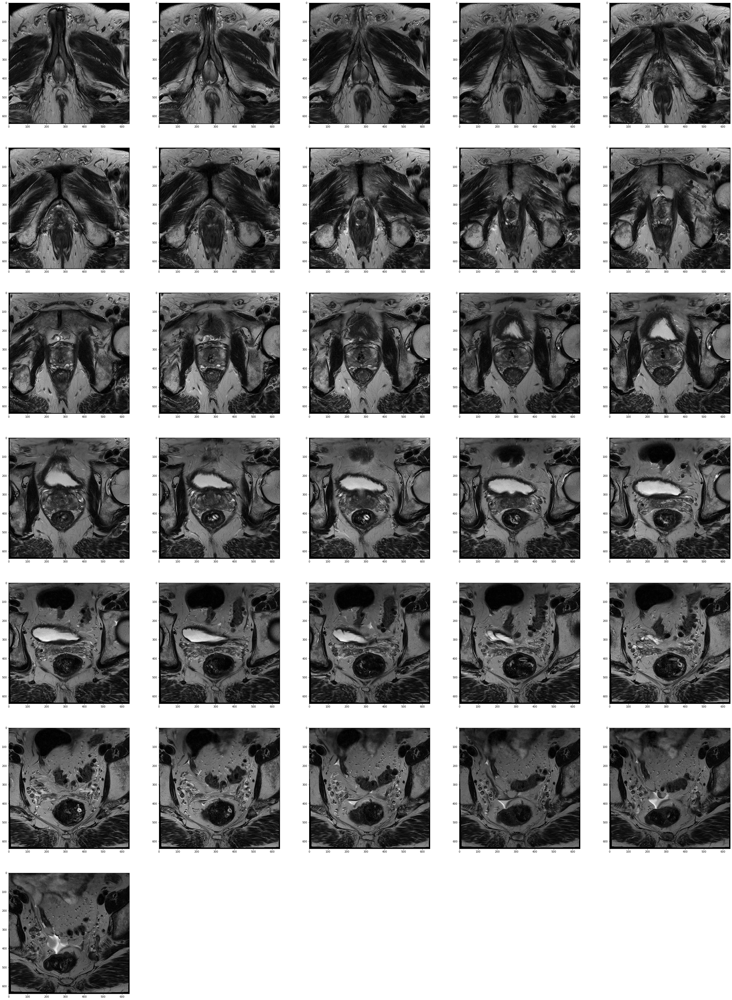

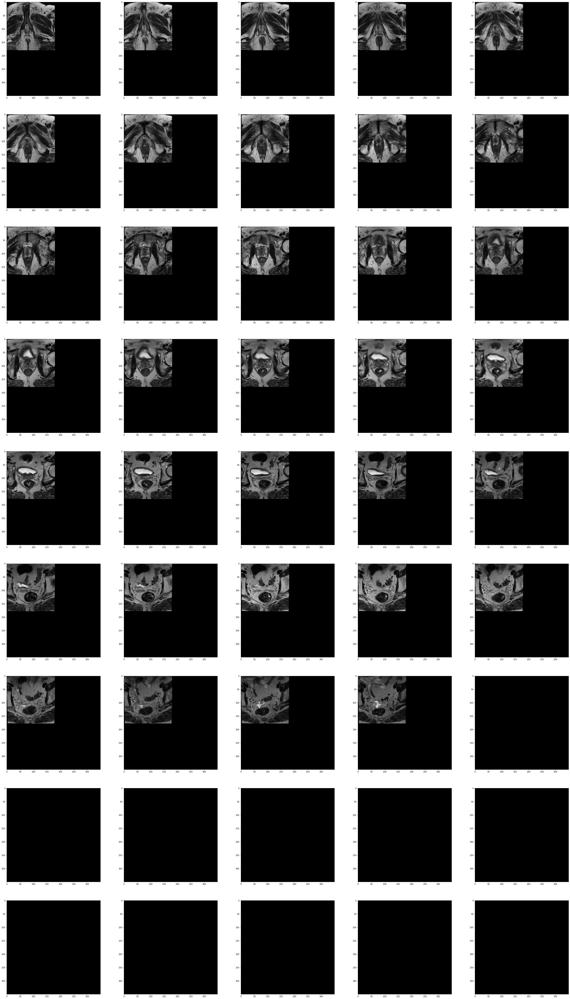

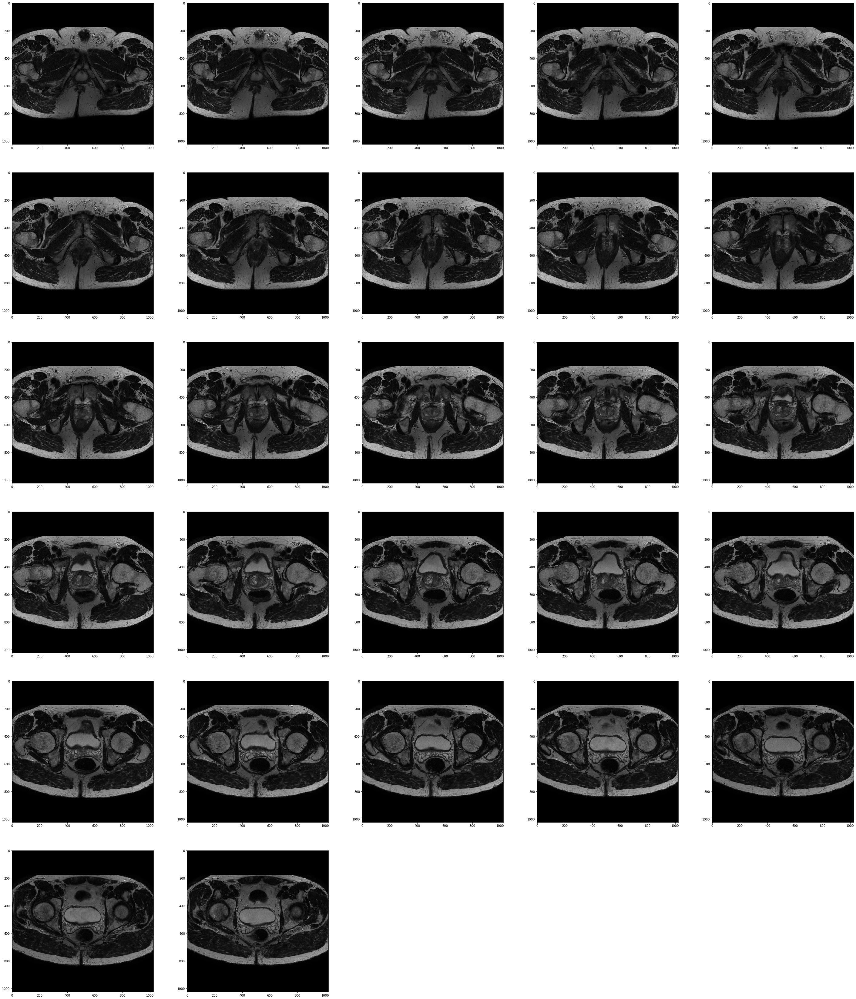

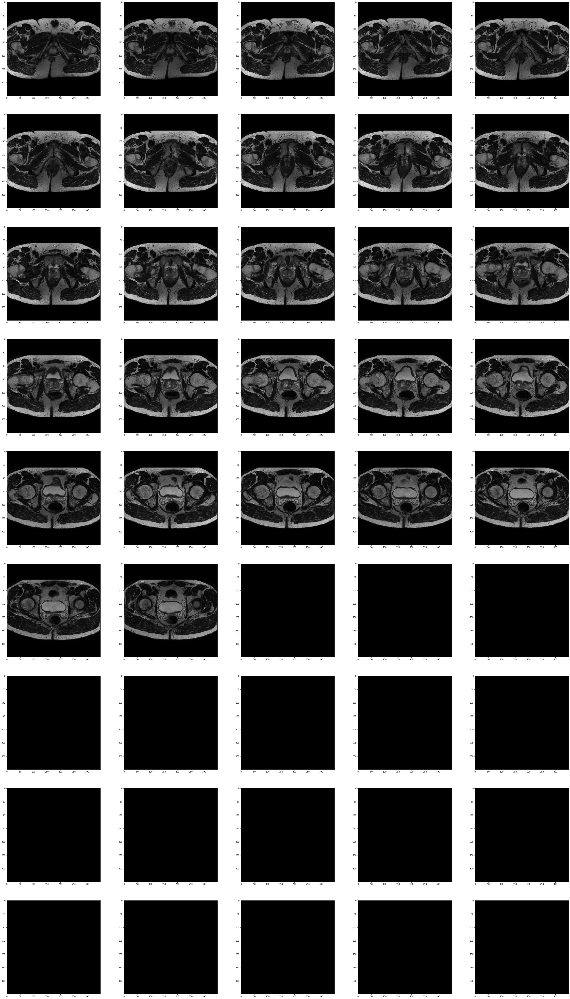

In [10]:
labels_path='/data1/practical-sose23/morphometric/picai_labels'
image_path='/data1/practical-sose23/morphometric/data'
modalities=["t2w"]
multiModel=False
biasFeildCorrection=False

#EXP1: STUPID RESULTS
targetVoxelShape= (1.0, 1.0, 3.0) #(0.5, 0.5, 3.0)#(1,1,1)
targetimageSize = [350, 350, 45]#(500,500,50)




glandSeg_path  = labels_path+"/anatomical_delineations/whole_gland/AI/Bosma22b"
canerSeg_path  = labels_path+"/csPCa_lesion_delineations/human_expert/resampled"
patient_id,patient_id_2=10000,10910
study_id,study_id_2= 1000000,1000927

def get_segmentations(patient_id,study_id):
        gland,cancer = None,None
        seg_path = "{0}/{1}_{2}.nii.gz".format(canerSeg_path,patient_id,study_id)
        scan = sitk.ReadImage(seg_path)
        gland=scan
        
        seg_path = "{0}/{1}_{2}.nii.gz".format(glandSeg_path,patient_id,study_id)
        cancer=scan

        return gland,cancer
    
def get_scans(patient_id,study_id):
    scans=[]
    for modality in modalities:
        # modality_scan = self.root+"/"+str(patient_id)+"/"+str(patient_id)+"_"+str(study_id)+"_"+modality+".mha"
        modality_path = "{0}/{1}/{1}_{2}_{3}.mha".format(image_path,patient_id,study_id,modality)
        scan = sitk.ReadImage(modality_path)
        scans.append(scan)
    return scans

def resample_image(image, gland,cancer, targetimageSize=None,targetVoxelShape = None):
        if targetimageSize is None: targetimageSize= image.GetSize()
        resample = sitk.ResampleImageFilter()
        resample.SetInterpolator = sitk.sitkLinear

        resample.SetOutputOrigin(image.GetOrigin())
        resample.SetOutputDirection(image.GetDirection())

        if targetVoxelShape is None:
            # resample.SetSize(targetimageSize) 
            resample.SetSize([int(i) for i in targetimageSize]) 
            resample.SetOutputSpacing(image.GetSpacing())
            resampled_image = image
        
        else:
            # resample.SetSize([int(image.GetSize()[i] * image.GetSpacing()[i] / targetVoxelShape[i]) for i in range(3)]) 
            resample.SetSize([int(i) for i in targetimageSize])
            resample.SetOutputSpacing(targetVoxelShape)
            resampled_image = resample.Execute(image)
        
        resampled_gland  = resample.Execute(gland)
        resampled_cancer = resample.Execute(cancer)
        
        return resampled_image,resampled_gland,resampled_cancer

def plot(img):
    import math 
    pixel_array = sitk.GetArrayFromImage(img)
    
    columns = 5
    rows = math.ceil(pixel_array.shape[0] / columns)
    fig = plt.figure(figsize=(50,rows*10))

    for i in range(pixel_array.shape[0]):
        fig.add_subplot(rows, columns, i+1)
        plt.imshow(pixel_array[i], cmap="gray", interpolation="none")


scans = get_scans(patient_id,study_id)
glandSeg, cancerSeg=get_segmentations(patient_id,study_id)
print(patient_id,study_id,"Before")
print("glandSeg",patient_id,study_id,glandSeg.GetSize(),glandSeg.GetSpacing())
print("scans[0]",patient_id,study_id,scans[0].GetSize(),scans[0].GetSpacing())
plot(scans[0])
print("==================================")
print(patient_id,study_id,"After")
scans[0],glandSeg, cancerSeg = resample_image(scans[0],glandSeg, cancerSeg, targetimageSize,targetVoxelShape) 
print("glandSeg",patient_id,study_id,glandSeg.GetSize(),glandSeg.GetSpacing())
print("scans[0]",patient_id,study_id,scans[0].GetSize(),scans[0].GetSpacing())
plot(scans[0])
print("==================================")
print("==================================")

#
print(patient_id,study_id,"Before")
scans = get_scans(patient_id_2,study_id_2)
glandSeg, cancerSeg=get_segmentations(patient_id_2,study_id_2)
print("glandSeg",patient_id_2,study_id_2,glandSeg.GetSize(),glandSeg.GetSpacing())
print("scans[0]",patient_id_2,study_id_2,scans[0].GetSize(),scans[0].GetSpacing())
plot(scans[0])
print("==================================")
print(patient_id,study_id,"After")
scans[0],glandSeg, cancerSeg = resample_image(scans[0],glandSeg, cancerSeg, targetimageSize,targetVoxelShape) 
print("glandSeg",patient_id_2,study_id_2,glandSeg.GetSize(),glandSeg.GetSpacing())
print("scans[0]",patient_id_2,study_id_2,scans[0].GetSize(),scans[0].GetSpacing())
plot(scans[0])
print("==================================")
print("==================================")

 
# 

scans[0]  = sitk.GetArrayFromImage(scans[0]).astype(float) 
glandSeg  = sitk.GetArrayFromImage(glandSeg).astype(float)
cancerSeg = sitk.GetArrayFromImage(cancerSeg).astype(float)

scans[0]  = torch.from_numpy(scans[0])#.permute(1, 0, 2)
glandSeg  = torch.from_numpy(glandSeg)#.permute(1, 0, 2)
cancerSeg = torch.from_numpy(cancerSeg)#.permute(1, 0, 2)

ground_truth_feat=(case_csPCa,glandSeg,cancerSeg)
training_feat=(scans[0])
# return training_feat,ground_truth_feat


In [ ]:
plot

In [202]:
glandSeg.GetSize()

(640, 640, 31)